# 24A - Overview

In [4]:
import fixr
import lookyloo
from lookyloo.core import get_matching_paths
import pathlib
import datetime
import numpy as np
from astropy.io import fits
from importlib import reload
from matplotlib import pyplot as plt


In [32]:
import spark_xrif as sx
dark_dir = '/opt/MagAOX/calib/camwfs-dark/'
reload(sx)

<module 'spark_xrif' from '/home/eden/code/testing/spark_xrif.py'>

## 03_23 HD12959

Parameters: 
loop 1564, cam freq	1800, mod radius	2.5, spark sep	15, spark amp	0.02, spark ang	0

In [33]:
# feq 1800 EM Gain 1 (?)
lab_dark = dark_dir + 'camwfs-dark_bin2_1800.000000_1.000000_-45.000000__T20240323005618680623195.fits'
#freq 1800 EM Gain 600
sky_dark = dark_dir + 'camwfs-dark_bin2_1800.000000_600.000000_-45.000000__T20240324234326026219038.fits'
sx_0323_HD129590 = sx.SparkXrif('HD129590_2x2bin_iz_unsats', 'spark_LAB_1564_1800_25mod_15ld_02amp', sky_dark, lab_dark, sx.glob_dir_calib, sx.glob_mask, sx.glob_ref)

Number of DATA files:  539648
Number of REF files:  177664
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 347
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442410 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442257 bytes
  ratio:              0.505

xrif compres

In [ ]:
lab_ref_data = sx_0323_HD129590.labref_norm
mask = sx_0323_HD129590.mask_nan

plt.title(f"2024Aa 03_23 HD129590: 15ld 0.02 spark, freq 1800 mod 2.5 \n GOOD DARKS ref sparkles, 1024 frames", y=0.90)
plt.plot()

NameError: name 'sx_0323_HD129590' is not defined

[]

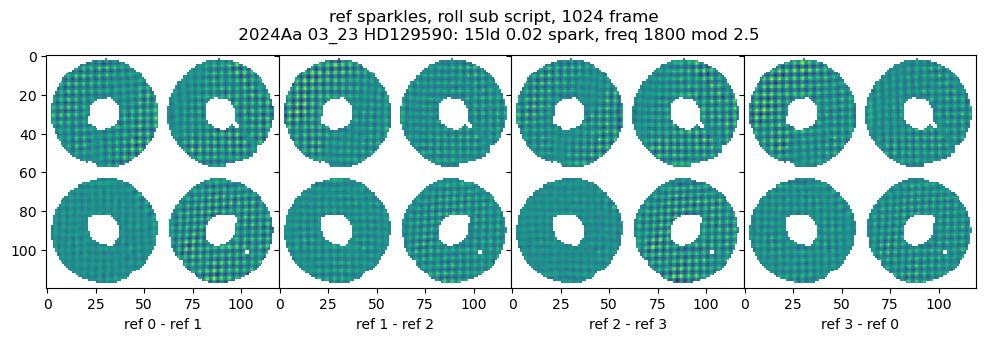

In [35]:
# taking pairwise differnce
# TODO: see if I need to just take the dataspit and not do the avg avg subtraction

#lab_ref_sub = lab_ref_data - np.roll(lab_ref_data, 1, axis=0)
lab_ref_sub = sx_0323_HD129590.labref_rollsub
mask = sx_0323_HD129590.mask_nan

# checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)

for e in range(4):
    axs[e].imshow(lab_ref_sub[e]*mask, vmax = np.max(lab_ref_sub), vmin = np.min(lab_ref_sub))
    axs[e].set_xlabel(f'ref {e} - ref {(e+1)%4}')

plt.suptitle(f"ref sparkles, roll sub script, 1024 frame \n 2024Aa 03_23 HD129590: 15ld 0.02 spark, freq 1800 mod 2.5", y=0.90)
plt.plot()

In [36]:
# differnces in their dot averages:         
print("Traditional Average: ", sx_0323_HD129590.ref_avg)
print("RollSub Average: ", sx_0323_HD129590.ref_rollsub)

Traditional Average:  [ 1.4777573e-05 -5.7958503e-05  5.8398102e-05  5.2728719e-06]
RollSub Average:  [7.0226160e-12 5.2844231e-12 6.6462877e-12 5.6488408e-12]


### Checking a set of files:

In [46]:
# check a set of turbulence frames:
turb_file_lists = sx.gen_file_list(sx_0323_HD129590.sky_obs_span)
clean_files, ts = sx_0323_HD129590.file_sample_n_clean(turb_file_lists, 512*20, lab=False)
data_splt = np.array(sx.split_data(clean_files))

PULLING 10240 FILES
FILE no 21, n_start 0, n 10240, n_offset 0
XRIF index 0, no of files 21, len list 1054
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7571271 bytes
  ratio:              0.513

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7569963 bytes
  ratio:              0.513

xrif compression details:
  difference method:  none
  reorder method:     none
  compr

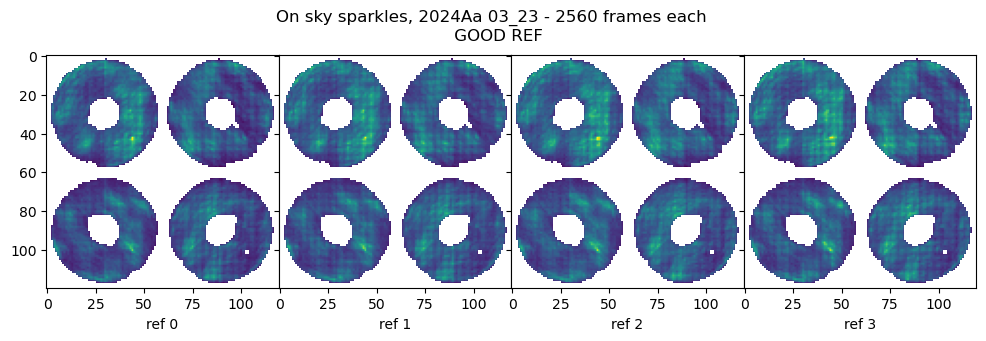

In [47]:
# checking the on sky files:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"On sky sparkles, 2024Aa 03_23 - 2560 frames each  \n GOOD REF", y=0.90)

sky_data = np.mean(data_splt, axis=1)

for e in range(4):
    axs[e].imshow(sky_data[e]*sx_0323_HD129590.mask_nan, label = f'ref {e}',)
    axs[e].set_xlabel(f"ref {e}")

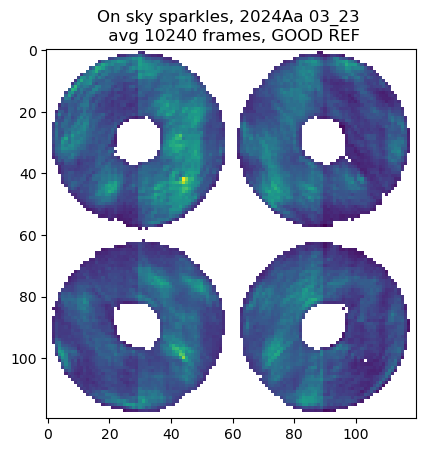

In [54]:
# Sum of all
plt.title(f"On sky sparkles, 2024Aa 03_23 \n avg 10240 frames, GOOD REF", y=1.0)
plt.imshow(np.sum(data_splt, axis=(0,1))*sx_0323_HD129590.mask_nan)


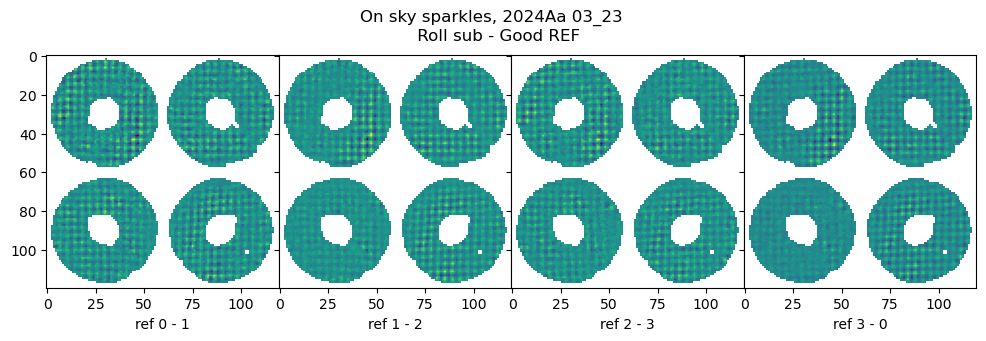

In [48]:
# checking the on sky files:
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"On sky sparkles, 2024Aa 03_23  \n Roll sub - Good REF", y=0.90)

sky_data = np.mean(data_splt, axis=1)

for e in range(4):
    e_i = (e+1)%4
    axs[e].imshow((sky_data[e] - sky_data[e_i])*sx_0323_HD129590.mask_nan, label = f'ref {e}',)
    axs[e].set_xlabel(f"ref {e} - {e_i}")

### Calculating dot products

In [40]:
n_avg = 1000
dot_sx_0323_HD129590_avg = sx_0323_HD129590.dot_list_pool_avg(n=500000, avg=n_avg, rollsub=True)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000]
N = 500000, chunk size = 4000,

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7579549 bytes
  ratio:              0.514

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7571485 bytes
  ratio:              0.513
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:    

split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

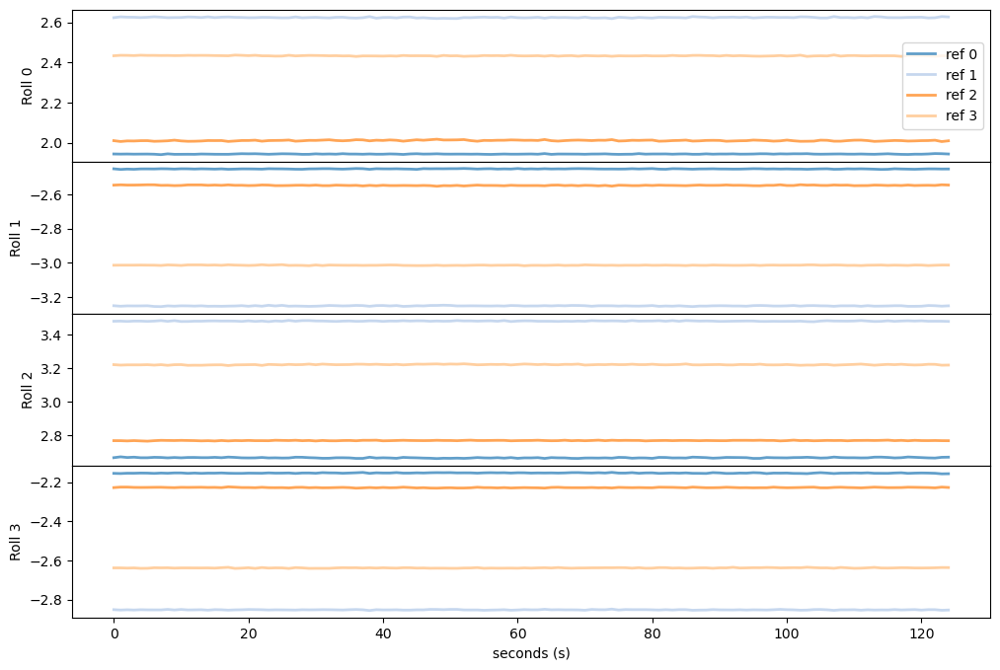

In [42]:
#PLOT: the four things
reload(sx)
data_allroll = np.array([sx.split_data_dot_roll(dot_sx_0323_HD129590_avg, roll=i) for i in range(4)])
sx.plot_time_series_roll(data_allroll, '', ref_avg = sx_0323_HD129590.ref_rollsub, hz=1800/(4*n_avg))

In [43]:
dot_sx_0323_HD129590_avg_deroll = sx.pick_roll(dot_sx_0323_HD129590_avg)

split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
Choosing roll index 2
split roll  (500, 4)


In [44]:
dot_sx_0323_HD129590_avg_deroll/4

array([[4.6772538e-12, 4.6860471e-12, 4.6790670e-12, 4.6823942e-12,
        4.6764762e-12, 4.6765322e-12, 4.6809934e-12, 4.6795137e-12,
        4.6751244e-12, 4.6790584e-12, 4.6756288e-12, 4.6794157e-12,
        4.6796126e-12, 4.6774676e-12, 4.6774737e-12, 4.6808013e-12,
        4.6767494e-12, 4.6833982e-12, 4.6802224e-12, 4.6754696e-12,
        4.6745251e-12, 4.6752198e-12, 4.6795350e-12, 4.6743564e-12,
        4.6757220e-12, 4.6735307e-12, 4.6743880e-12, 4.6821587e-12,
        4.6815416e-12, 4.6773176e-12, 4.6751643e-12, 4.6707898e-12,
        4.6713822e-12, 4.6762516e-12, 4.6765196e-12, 4.6751544e-12,
        4.6696366e-12, 4.6697281e-12, 4.6820720e-12, 4.6732457e-12,
        4.6761735e-12, 4.6742107e-12, 4.6706129e-12, 4.6804921e-12,
        4.6771675e-12, 4.6756913e-12, 4.6729842e-12, 4.6714928e-12,
        4.6678416e-12, 4.6715617e-12, 4.6704697e-12, 4.6723827e-12,
        4.6700070e-12, 4.6731950e-12, 4.6786060e-12, 4.6750108e-12,
        4.6736963e-12, 4.6771120e-12, 4.6725419e

<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

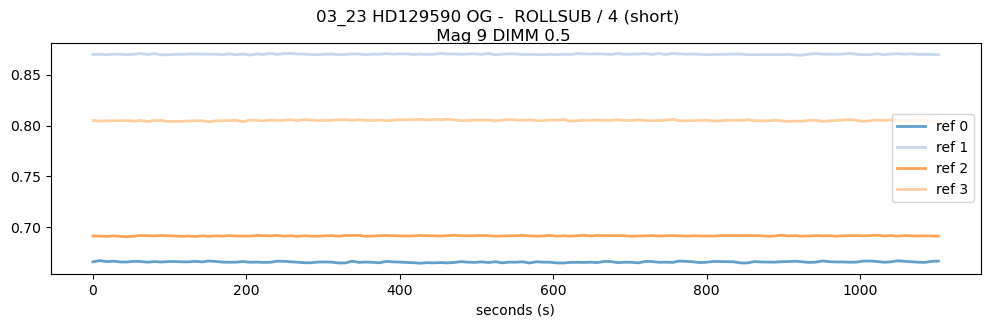

In [45]:
data = dot_sx_0323_HD129590_avg_deroll
ref = sx_0323_HD129590.ref_rollsub
title ='03_23 HD129590 OG -  ROLLSUB / 4 (short) \n Mag 9 DIMM 0.5'

sx.plot_time_series(data/4, title, ref_avg = ref, hz=1800/(4*n_avg))

### Check against selfRMs

In [72]:
selfRM_dir = '~/data/selfRM/'
testRMs_1800_3 = selfRM_dir + 'selfRM_20240324_1564mode_1800Hz_3mod.fits'
skyRMs_1800 = selfRM_dir +'selfRM_20240323_1800Hz_1564modes_15l_02amp_spark.fits'


data_sky1800= np.diag(fits.open(skyRMs_1800)[0].data[5])
data_1800_3 = np.diag(fits.open(testRMs_1800_3)[0].data[5])

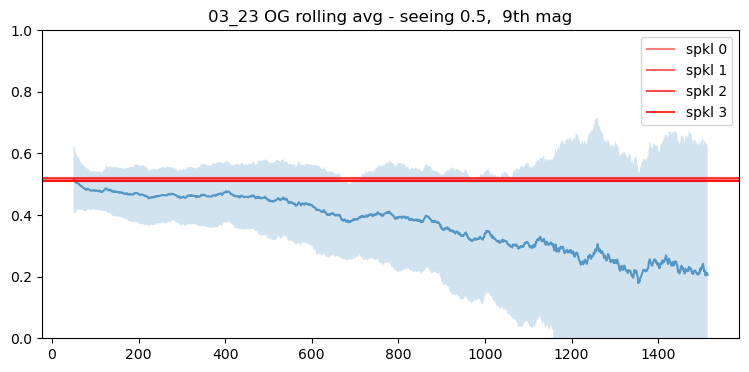

In [83]:
# over plot that 
# spark OG measurements

spkl_img_avg  = np.mean(results_avg_deroll, axis=1)
spkl_og = spkl_img_avg / test_sx.ref_avg

# roling averages: 
mean_0323, std_0323 = sx.return_rolling(data_sky1800/data_1800_3)
X_shift = np.arange(50, mean_0323.shape[0] + 50)

#plot set up 
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(9, 4), facecolor='white', sharex=True)

plt.fill_between(X_shift, mean_0323 - std_0323, mean_0323 + std_0323, alpha = 0.2,)
plt.plot(X_shift, mean_0323, alpha=0.7 )

for i in range(4):
    plt.axhline(spkl_og[i], alpha=0.5 + 0.1*i, label=f'spkl {i}', color = 'r')

plt.ylim(0, 1)
plt.title('03_23 OG rolling avg - seeing 0.5,  9th mag')
plt.legend()
plt.show()

### check longer 03_23 dataset

In [134]:
sx_03_23_long = sx.SparkXrif('HD129590_2x2bin_iz_smlyot', 'spark_LAB_1564_1800_25mod_15ld_02amp', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref)

Number of DATA files:  13762048
Number of REF files:  177664
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 347
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442410 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442257 bytes
  ratio:              0.505

xrif compr

In [138]:
n_avg = 1000
long_0323_results_avg = sx_03_23_long.dot_list_pool_avg(n=10000000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000, 500000, 504000, 508000, 512000

In [139]:
long_0323_results_avg_deroll = sx.pick_roll(long_0323_results_avg)

split roll  (10000, 4)
split roll  (10000, 4)
split roll  (10000, 4)
split roll  (10000, 4)
Choosing roll index 2
split roll  (10000, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

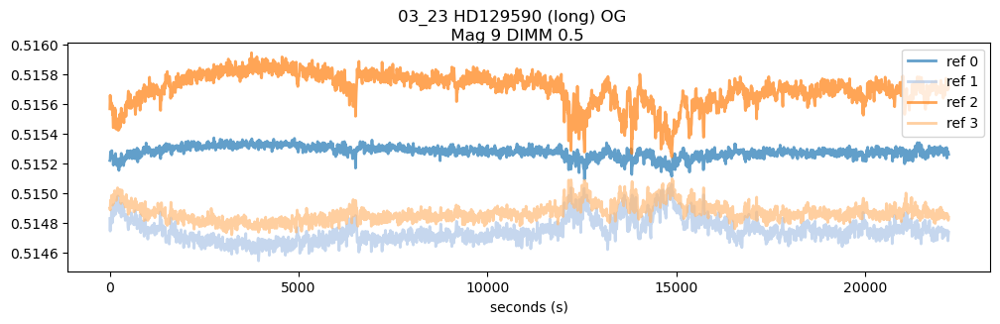

In [140]:
sx.plot_time_series(long_0323_results_avg_deroll, '03_23 HD129590 (long) OG \n Mag 9 DIMM 0.5', ref_avg = sx_03_23_long.ref_avg, hz=1800/(4*n_avg))

## 03_22 HD145560
Parameters: 1564,	Loop speed: 1800, Mod radius:	3, spark sep	15, spark amp	0.02, spark ang	0

In [142]:
sx_0322_HD145560 = sx.SparkXrif('HD145560_lysm', 'spark_LAB_1564_1800_2mod_15ld_02amp', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 0)

Number of DATA files:  1608192
Number of REF files:  325632
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 636
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442438 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442401 bytes
  ratio:              0.505

xrif compre

NameError: name 'sx_0322_HD145560' is not defined

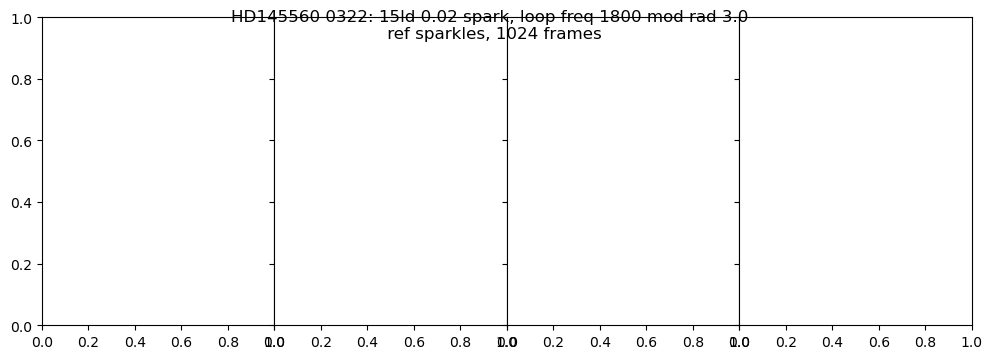

In [32]:
#checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"HD145560 0322: 15ld 0.02 spark, loop freq 1800 mod rad 3.0 \n ref sparkles, 1024 frames", y=0.90)

lab_ref_data = sx_0322_HD145560.labref_norm
mask = sx_0322_HD145560.mask_nan

for e in range(4):
    axs[e].imshow(lab_ref_data[e]*mask, label = f'ref {e}', vmax = np.max(lab_ref_data), vmin = np.min(lab_ref_data))
    axs[e].set_xlabel(f"ref {e}")

In [146]:
n_avg = 1000
dot_0322_avg = sx_0322_HD145560.dot_list_pool_avg(n=1500000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000, 500000, 504000, 508000, 512000

In [147]:
dot_0322_avg_deroll = sx.pick_roll(dot_0322_avg)

split roll  (1500, 4)
split roll  (1500, 4)
split roll  (1500, 4)
split roll  (1500, 4)
Choosing roll index 0
split roll  (1500, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

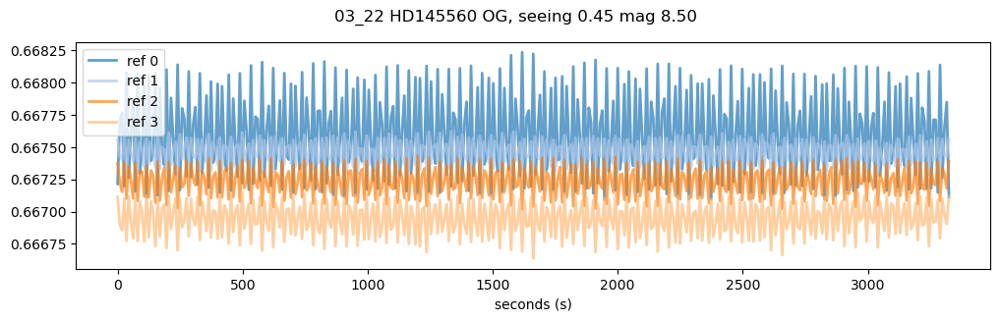

In [149]:
sx.plot_time_series(dot_0322_avg_deroll, '03_22 HD145560 OG, seeing 0.45 mag 8.50 ', ref_avg = sx_0322_HD145560.ref_avg, hz=1800/(4*n_avg))

In [36]:
cut = int(832/16)

[]

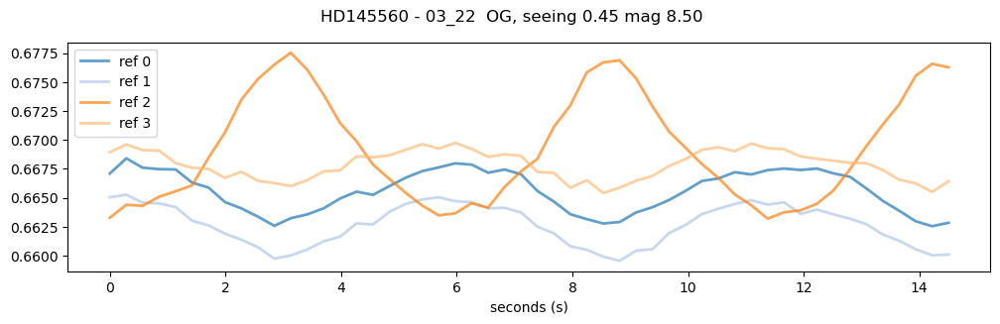

In [37]:
sx.plot_time_series(dot_0322_avg_deroll[:, :cut], 'HD145560 - 03_22  OG, seeing 0.45 mag 8.50 ', ref_avg = sx_0322_HD145560.ref_avg, hz=1800/128)
#plt.ylim(0,1)
plt.plot()

## 03_20 HD61005_smlyot_zi

1564	2000	2	15	0.02	0

In [52]:
reload(sx)

<module 'spark_xrif' from '/home/eden/code/testing/spark_xrif.py'>

In [53]:
sx_0320_HD61005 = sx.SparkXrif('HD61005_smlyot_zi', 'spark_LAB_1564_2000_2mod_15ld_02amp', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 0)

Number of DATA files:  5131264
Number of REF files:  239104
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 467
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442120 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442121 bytes
  ratio:              0.505

xrif compre

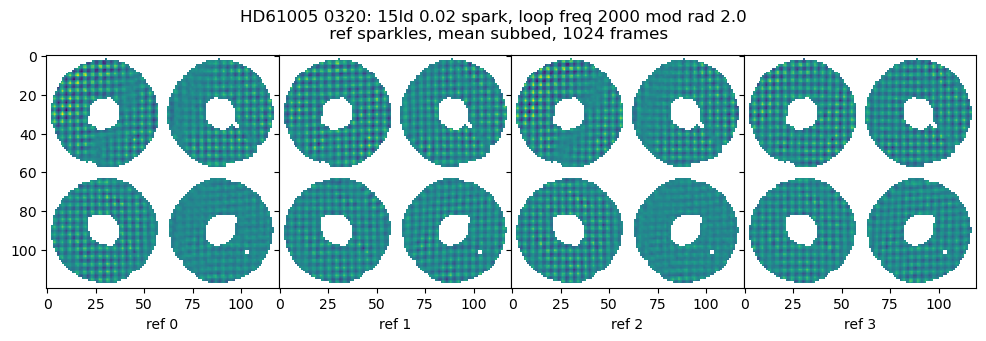

In [45]:
#checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"HD61005 0320: 15ld 0.02 spark, loop freq 2000 mod rad 2.0 \n ref sparkles, mean subbed, 1024 frames", y=0.90)

lab_ref_data = sx_0320_HD61005.labref_norm

for e in range(4):
    axs[e].imshow(lab_ref_data[e]*sx_0320_HD61005.mask_nan, label = f'ref {e}', vmax = np.max(lab_ref_data), vmin = np.min(lab_ref_data))
    axs[e].set_xlabel(f"ref {e}")

In [69]:
turb_file_lists = sx.gen_file_list(sx_0320_HD61005.sky_obs_span)
clean_files, ts = sx_0320_HD61005.file_sample_n_clean(turb_file_lists, 16000)
data_splt = np.array(sx.split_data(clean_files))

PULLING 16000 FILES
FILE no 32, n_start 0, n 16000, n_offset 0
XRIF index 0, no of files 32, len list 10022
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       8034812 bytes
  ratio:              0.545

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       8032320 bytes
  ratio:              0.545

xrif compression details:
  difference method:  none
  reorder method:     none
  comp

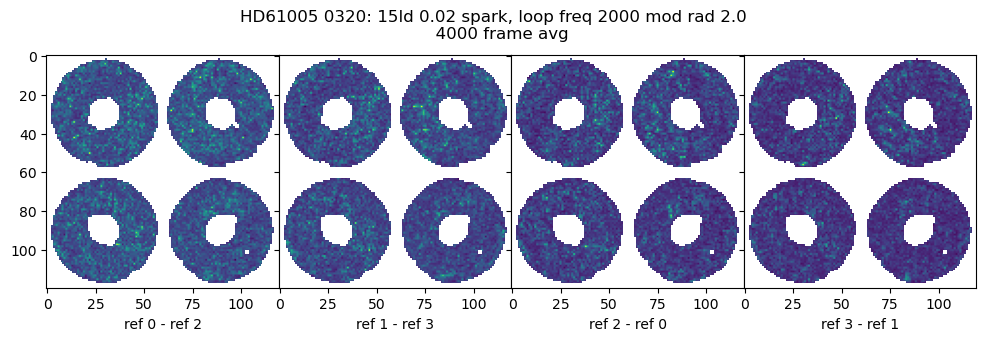

In [157]:


#checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"HD61005 0320: 15ld 0.02 spark, loop freq 2000 mod rad 2.0 \n  4000 frame avg", y=0.90)

for e in range(4):
    axs[e].imshow((data_splt[e,0])*test_sx.mask_nan)
    axs[e].set_xlabel(f'ref {e} - ref {(e+2) %4}')

In [160]:
data_splt.shape

(4, 4000, 120, 120)

In [167]:
dot_then_avg =  np.array([np.mean([sx_0320_HD61005.dot_data(data_splt[i,e]) for e in range(1000)], axis=0) for i in range(4)])

In [169]:
dot_then_avg

array([[ 1.6654827e-05,  1.7512351e-05, -1.7412769e-05, -1.7467679e-05],
       [ 1.6653767e-05,  1.7489909e-05, -1.7413273e-05, -1.7442999e-05],
       [ 1.6648195e-05,  1.7511868e-05, -1.7411370e-05, -1.7462902e-05],
       [ 1.6653605e-05,  1.7522874e-05, -1.7400434e-05, -1.7487924e-05]],
      dtype=float32)

In [174]:
data_allroll = np.mean(np.array([sx.split_data_dot_roll(dot_0320_avg_stack, roll=i) for i in range(4)]), axis=2)
    

split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)


In [176]:
data_allroll.T

array([[ 1.6652353e-05,  1.7511305e-05, -1.7411232e-05, -1.7465845e-05],
       [ 1.6651906e-05,  1.7496850e-05, -1.7413411e-05, -1.7448589e-05],
       [ 1.6648954e-05,  1.7510971e-05, -1.7410617e-05, -1.7463213e-05],
       [ 1.6652333e-05,  1.7519405e-05, -1.7402892e-05, -1.7481199e-05]],
      dtype=float32)

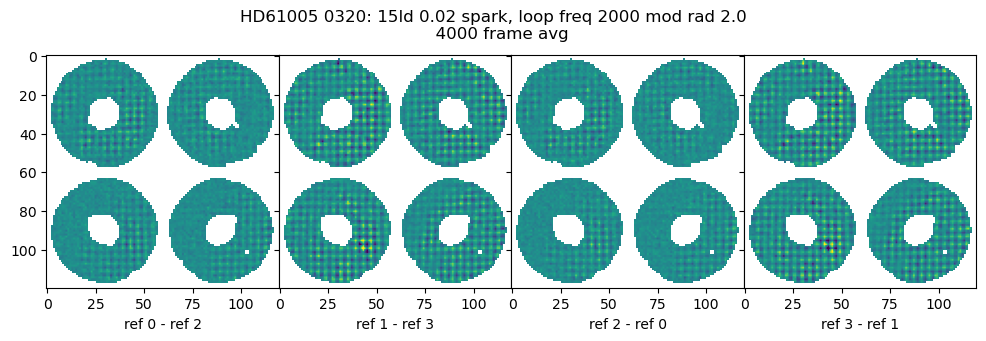

In [94]:
#checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"HD61005 0320: 15ld 0.02 spark, loop freq 2000 mod rad 2.0 \n  4000 frame avg", y=0.90)

sky_ref_data = np.mean(data_splt, axis=1)

p_max = np.max(sky_ref_data[0]-sky_ref_data[1])
p_min = np.min(sky_ref_data[0]-sky_ref_data[1])

for e in range(4):
    axs[e].imshow((sky_ref_data[e]-sky_ref_data[(e+2) % 4])*test_sx.mask_nan, vmax=p_max, vmin=p_min)
    axs[e].set_xlabel(f'ref {e} - ref {(e+2) %4}')

In [ ]:
sky_ref_data

In [74]:
n_avg = 4000
dot_0320_avg = sx_0320_HD61005.dot_list_pool_avg(n=2000000, avg=n_avg)

[0, 16000, 32000, 48000, 64000, 80000, 96000, 112000, 128000, 144000, 160000, 176000, 192000, 208000, 224000, 240000, 256000, 272000, 288000, 304000, 320000, 336000, 352000, 368000, 384000, 400000, 416000, 432000, 448000, 464000, 480000, 496000, 512000, 528000, 544000, 560000, 576000, 592000, 608000, 624000, 640000, 656000, 672000, 688000, 704000, 720000, 736000, 752000, 768000, 784000, 800000, 816000, 832000, 848000, 864000, 880000, 896000, 912000, 928000, 944000, 960000, 976000, 992000, 1008000, 1024000, 1040000, 1056000, 1072000, 1088000, 1104000, 1120000, 1136000, 1152000, 1168000, 1184000, 1200000, 1216000, 1232000, 1248000, 1264000, 1280000, 1296000, 1312000, 1328000, 1344000, 1360000, 1376000, 1392000, 1408000, 1424000, 1440000, 1456000, 1472000, 1488000, 1504000, 1520000, 1536000, 1552000, 1568000, 1584000, 1600000, 1616000, 1632000, 1648000, 1664000, 1680000, 1696000, 1712000, 1728000, 1744000, 1760000, 1776000, 1792000, 1808000, 1824000, 1840000, 1856000, 1872000, 1888000, 19

In [75]:
dot_0320_avg_stack = np.vstack(dot_0320_avg)

In [105]:
dot_0320_avg_deroll = sx.pick_roll(dot_0320_avg_stack)

split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
Choosing roll index 1
split roll  (500, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

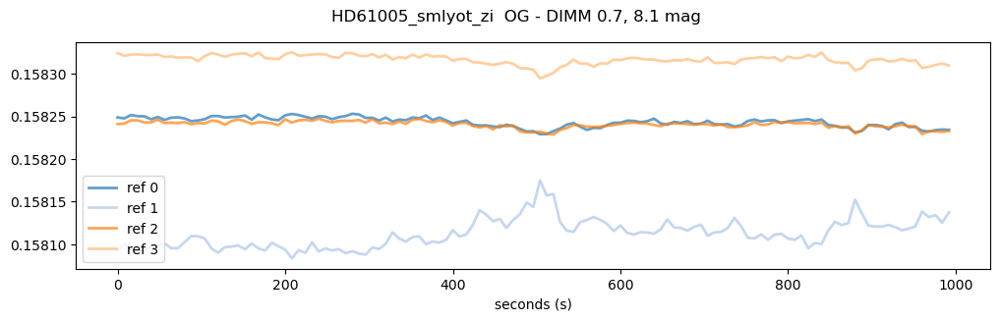

In [106]:
sx.plot_time_series(dot_0320_avg_deroll, f'HD61005_smlyot_zi  OG - DIMM 0.7, 8.1 mag, avg = {n_avg} ', ref_avg = sx_0320_HD61005.ref_avg, hz=2000/(4*n_avg))

### Checking thhe new pair roll sub

[]

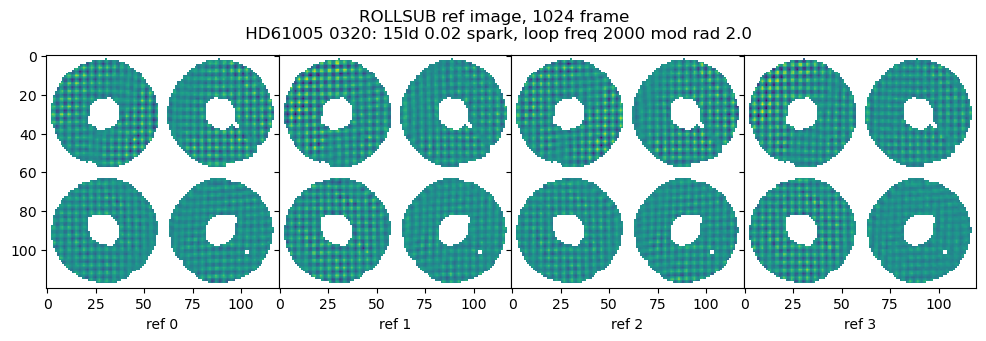

In [55]:
#checking rollsub lab
lab_ref_sub = sx_0320_HD61005.labref_rollsub
mask = sx_0320_HD61005.mask_nan

# checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)

for e in range(4):
    axs[e].imshow(lab_ref_sub[e]*mask, label = f'ref {e}', vmax = np.max(lab_ref_sub), vmin = np.min(lab_ref_sub))
    axs[e].set_xlabel(f"ref {e}")

plt.suptitle(f"ROLLSUB ref image, 1024 frame \n HD61005 0320: 15ld 0.02 spark, loop freq 2000 mod rad 2.0", y=0.90)
plt.plot()

In [54]:
n_avg = 1000
sx_0320_HD61005_avg_rollsub = sx_0320_HD61005.dot_list_pool_avg(n=500000, avg=n_avg, rollsub=True)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000]
N = 500000, chunk size = 4000,

In [56]:
dot_sx_0323_HD129590_avg_rollsub_deroll = sx.pick_roll(sx_0320_HD61005_avg_rollsub)

split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
split roll  (500, 4)
Choosing roll index 2
split roll  (500, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

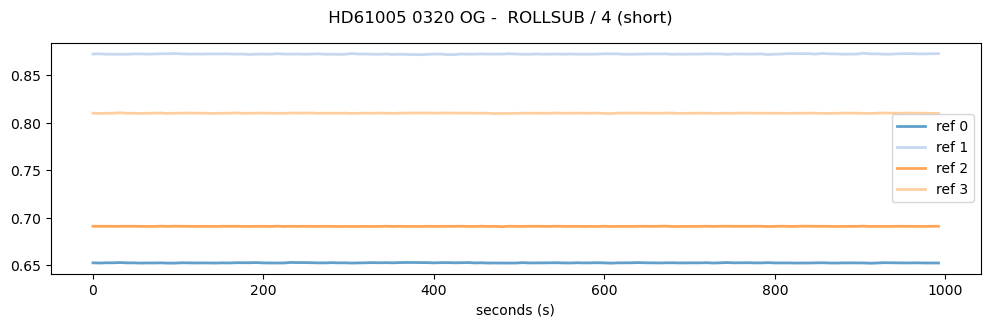

In [58]:
data = dot_sx_0323_HD129590_avg_rollsub_deroll
ref = sx_0323_HD129590.ref_rollsub
title =' HD61005 0320 OG -  ROLLSUB / 4 (short) '

sx.plot_time_series(data/4, title, ref_avg = ref, hz=2000/(4*n_avg))

## 3_26 EFC_beta_pictoris_run_03

sparkles were only added halfway through, a good test, no?

In [59]:
sx_0326_betaPic_03 = sx.SparkXrif('EFC_beta_pictoris_run_03', 'spark_LAB_1564_2000_25mod_20ld_02amp_45ang', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 0)

Number of DATA files:  854016
Number of REF files:  451072
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 881
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7491323 bytes
  ratio:              0.508

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7491868 bytes
  ratio:              0.508

xrif compres

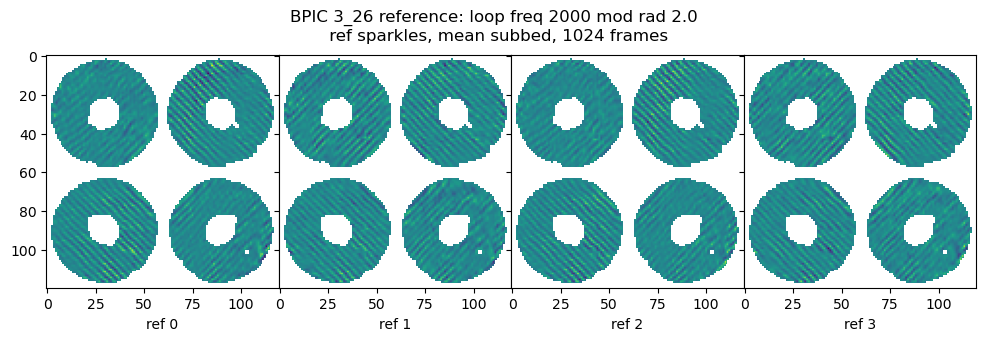

In [60]:
#checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)
plt.suptitle(f"BPIC 3_26 reference: loop freq 2000 mod rad 2.0 \n ref sparkles, mean subbed, 1024 frames", y=0.90)

lab_ref_data = sx_0326_betaPic_03.labref_norm

for e in range(4):
    axs[e].imshow(lab_ref_data[e]*sx_0326_betaPic_03.mask_nan, label = f'ref {e}', vmax = np.max(lab_ref_data), vmin = np.min(lab_ref_data))
    axs[e].set_xlabel(f"ref {e}")

In [116]:
n_avg = 1000
dot_0326_BP3_avg = sx_0326_betaPic_03.dot_list_pool_avg(n=800000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000, 500000, 504000, 508000, 512000

In [117]:
dot_0326_BP3_avg = np.vstack(dot_0326_BP3_avg)

split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

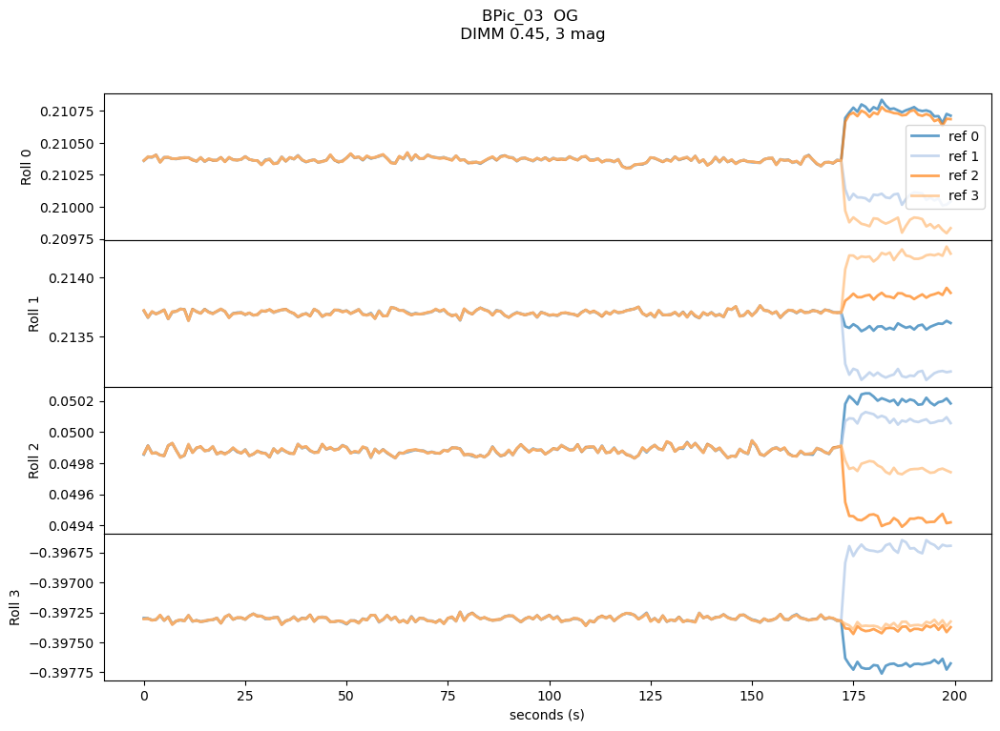

In [153]:
reload(sx)
data_allroll = np.array([sx.split_data_dot_roll(dot_0326_BP3_avg, roll=i) for i in range(4)])
sx.plot_time_series_roll(data_allroll, 'BPic_03  OG \n DIMM 0.45, 3 mag ', ref_avg = sx_0326_betaPic_03.ref_avg, hz=2000/(4*n_avg))

In [118]:
dot_0326_BP3_avg_deroll = sx.pick_roll(dot_0326_BP3_avg)

split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)
Choosing roll index 1
split roll  (800, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

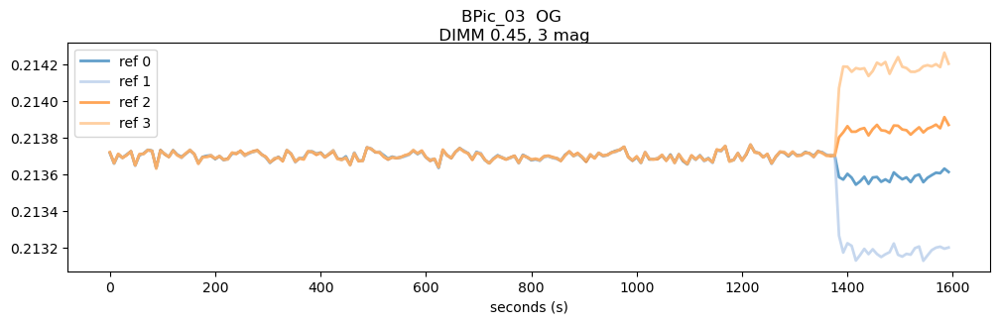

In [119]:
sx.plot_time_series(dot_0326_BP3_avg_deroll, 'BPic_03  OG \n DIMM 0.45, 3 mag ', ref_avg = sx_0326_betaPic_03.ref_avg, hz=2000/(4*n_avg))

### check the new roll code

[]

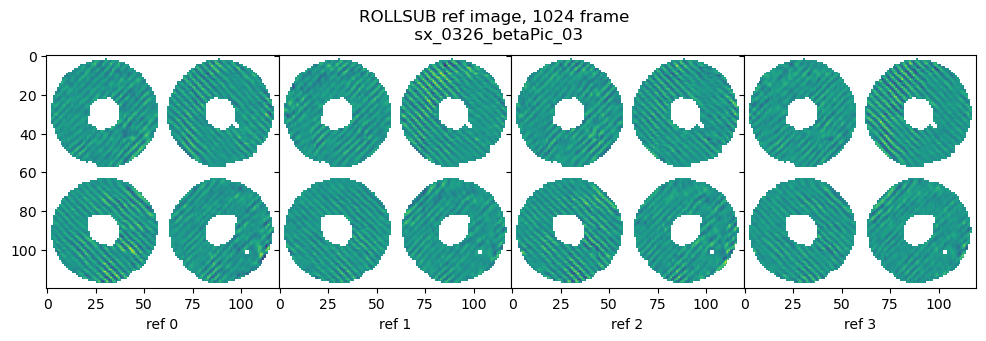

In [61]:
#checking rollsub lab
lab_ref_sub = sx_0326_betaPic_03.labref_rollsub
mask = sx_0326_betaPic_03.mask_nan

# checking the lab reference: 
fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(12,4), facecolor='white', sharey=True)
fig.subplots_adjust(wspace=0)

for e in range(4):
    axs[e].imshow(lab_ref_sub[e]*mask, label = f'ref {e}', vmax = np.max(lab_ref_sub), vmin = np.min(lab_ref_sub))
    axs[e].set_xlabel(f"ref {e}")

plt.suptitle(f"ROLLSUB ref image, 1024 frame \n sx_0326_betaPic_03", y=0.90)
plt.plot()

In [62]:
n_avg = 1000
dot_0326_BP3_rollsub_avg = sx_0326_betaPic_03.dot_list_pool_avg(n=800000, avg=n_avg, rollsub=True)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000, 500000, 504000, 508000, 512000

split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)
split roll  (800, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

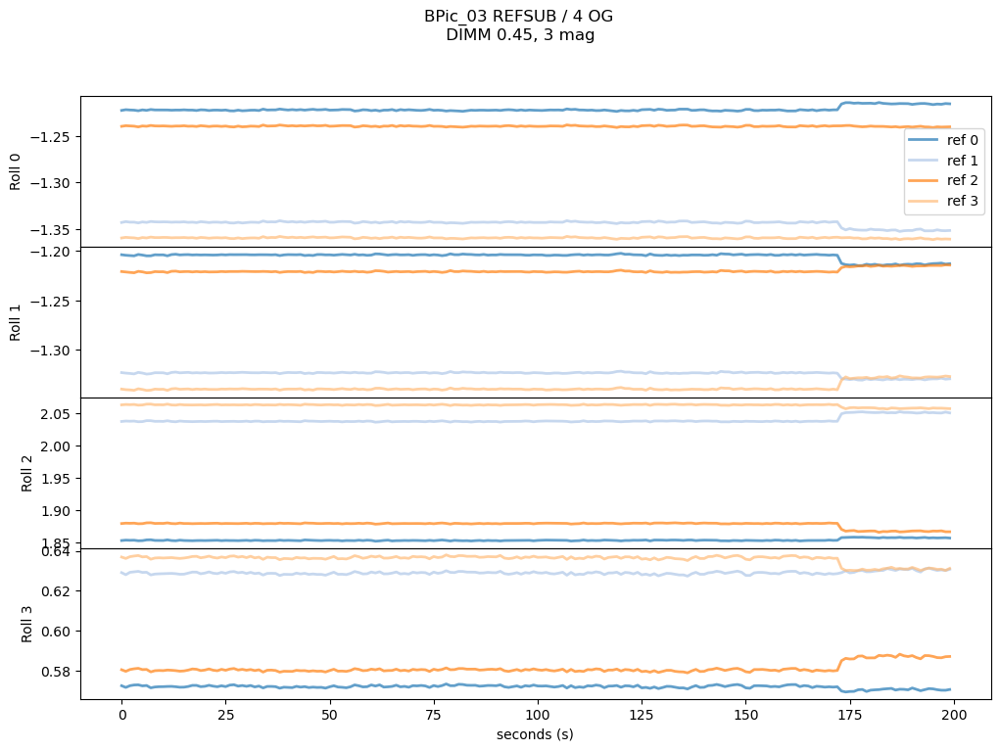

In [66]:
data_allroll = np.array([sx.split_data_dot_roll(dot_0326_BP3_rollsub_avg, roll=i) for i in range(4)])

ref = sx_0326_betaPic_03.ref_rollsub
title = 'BPic_03 REFSUB / 4 OG \n DIMM 0.45, 3 mag '

sx.plot_time_series_roll(data_allroll/4, title, ref_avg = ref, hz=2000/(4*n_avg))

## 03_26 BetaPic 04

In [121]:
reload(sx)

<module 'spark_xrif' from '/home/eden/code/testing/spark_xrif.py'>

In [122]:
sx_0326_betaPic_04 = sx.SparkXrif('EFC_beta_pictoris_run_04', 'spark_LAB_1564_2000_25mod_20ld_02amp_45ang', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 0)

Number of DATA files:  1468928
Number of REF files:  451072
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 881
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7491323 bytes
  ratio:              0.508

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7491868 bytes
  ratio:              0.508

xrif compre

In [124]:
n_avg = 1000
dot_0326_BP4_avg = sx_0326_betaPic_04.dot_list_pool_avg(n=1000000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000, 200000, 204000, 208000, 212000, 216000, 220000, 224000, 228000, 232000, 236000, 240000, 244000, 248000, 252000, 256000, 260000, 264000, 268000, 272000, 276000, 280000, 284000, 288000, 292000, 296000, 300000, 304000, 308000, 312000, 316000, 320000, 324000, 328000, 332000, 336000, 340000, 344000, 348000, 352000, 356000, 360000, 364000, 368000, 372000, 376000, 380000, 384000, 388000, 392000, 396000, 400000, 404000, 408000, 412000, 416000, 420000, 424000, 428000, 432000, 436000, 440000, 444000, 448000, 452000, 456000, 460000, 464000, 468000, 472000, 476000, 480000, 484000, 488000, 492000, 496000, 500000, 504000, 508000, 512000

In [126]:
dot_0326_BP4_avg_deroll = sx.pick_roll(dot_0326_BP4_avg)

split roll  (1000, 4)
split roll  (1000, 4)
split roll  (1000, 4)
split roll  (1000, 4)
Choosing roll index 1
split roll  (1000, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

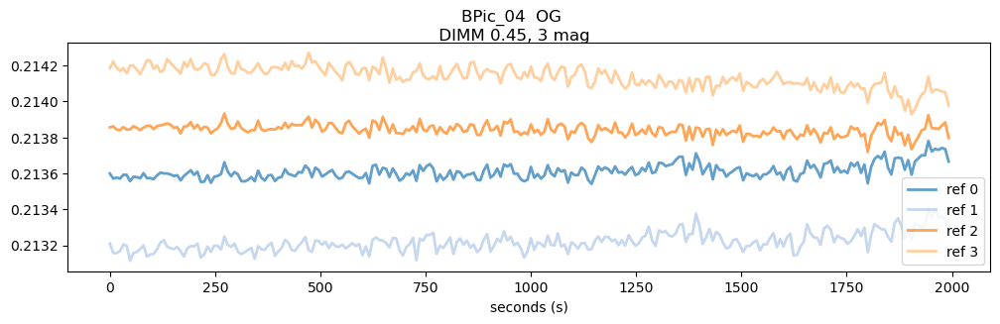

In [127]:
sx.plot_time_series(dot_0326_BP4_avg_deroll, 'BPic_04  OG \n DIMM 0.45, 3 mag ', ref_avg = sx_0326_betaPic_04.ref_avg, hz=2000/(4*n_avg))

## 03_25 alfAnt
THis dataset is probably trash

spark_sky_alfAnt_15sep_02amp		1564	2000	2.5	15	0.02	0

spark_sky_alfAnt_15sep_05amp					15	0.05	0

spark_sky_alfAnt_20sep_02amp					20	0.02	0

spark_sky_alfAnt_20sep_05amp					20	0.05	0

## 03_28  HD106906

Params changed in different configurations

HD106906_iz_smlyot					13	0.02

spark_LAB_1564_1800_25mod_13ld_02amp_r (lab is actually taken at 2000Hz)

In [4]:
sx_0328_HD106906 = sx.SparkXrif('HD106906_iz_smlyot', 'spark_LAB_1564_1800_25mod_13ld_02amp_r', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 0)

Number of DATA files:  245248
Number of REF files:  174080
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 340
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442408 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442404 bytes
  ratio:              0.505

xrif compres

In [5]:
n_avg = 1000
dot_0328_HD106906_avg = sx_0328_HD106906.dot_list_pool_avg(n=200000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000]
N = 200000, chunk size = 4000, N_Chunks 50
PULLING 4000 FILES
PULLING 4000 FILESFILE no 8, n_start 0, n 4000, n_offset 0

FILE no 8, n_start 52000, n 4000, n_offset 288XRIF index 0, no of files 8, len list 479

XRIF index 101, no of files 8, len list 479PULLING 4000 FILES

FILE no 8, n_start 104000, n 4000, n_offset 64
PULLING 4000 FILESXRIF index 203, no of files 8, len list 479

FILE no 8, n_start 156000, n 4000, n_offset 352
XRIF index 304, no of files 8, len list 479
chunksize=13, n_workers=4
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 accele

split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

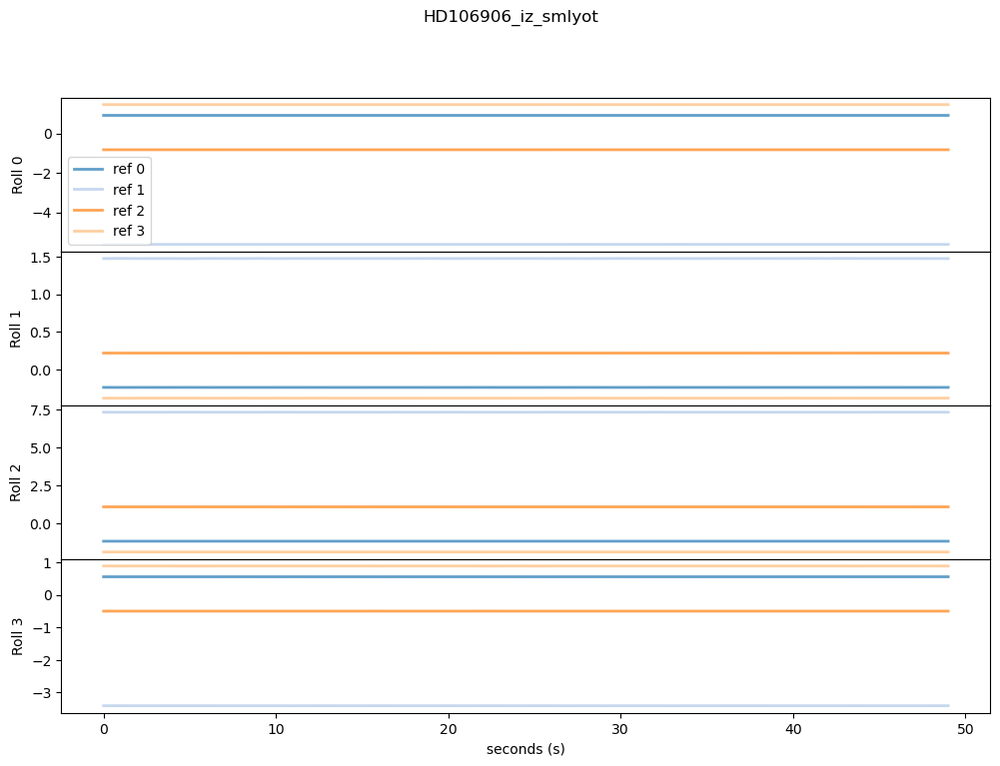

In [9]:
reload(sx)
data_allroll = np.array([sx.split_data_dot_roll(dot_0328_HD106906_avg, roll=i) for i in range(4)])
sx.plot_time_series_roll(data_allroll, 'HD106906_iz_smlyot', ref_avg = sx_0328_HD106906.ref_avg, hz=2000/(4*n_avg))

In [6]:
dot_0328_HD106906_avg_deroll = sx.pick_roll(dot_0328_HD106906_avg)

split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
Choosing roll index 0
split roll  (200, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

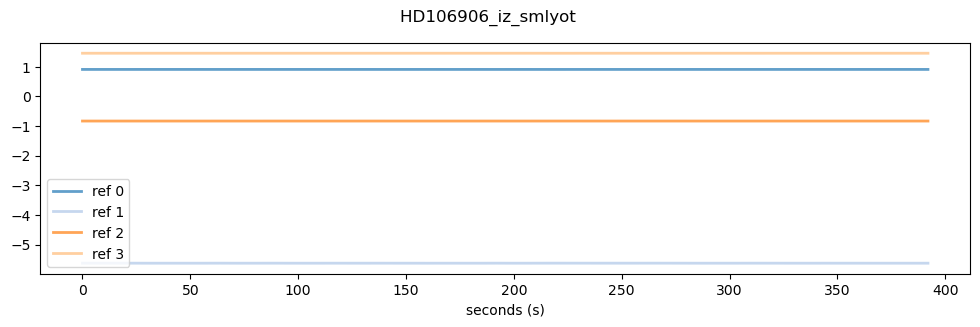

In [7]:
sx.plot_time_series(dot_0328_HD106906_avg_deroll, 'HD106906_iz_smlyot ', ref_avg = sx_0328_HD106906.ref_avg, hz=2000/(4*n_avg))

## 03_28 HR 4796
Two 5 min long datasets


HR4796_2x2binning_iz_smlyot		1564	2000	2.5	15	0.02	0

spark_LAB_1564_2000_2mod_15ld_02amp

In [11]:
sx_0328_HR4796 = sx.SparkXrif('HR4796_2x2binning_iz_smlyot', 'spark_LAB_1564_2000_2mod_15ld_02amp', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 1)

Number of DATA files:  657920
Number of REF files:  239104
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 467
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442120 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442121 bytes
  ratio:              0.505

xrif compres

In [12]:
n_avg = 1000
dot_0328_HR4796_avg = sx_0328_HR4796.dot_list_pool_avg(n=200000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000]
N = 200000, chunk size = 4000, N_Chunks 50
PULLING 4000 FILES
FILE no 8, n_start 0, n 4000, n_offset 0
XRIF index 0, no of files 8, len list 1285
PULLING 4000 FILES
FILE no 8, n_start 52000, n 4000, n_offset 288
XRIF index 101, no of files 8, len list 1285
PULLING 4000 FILES
FILE no 8, n_start 104000, n 4000, n_offset 64
XRIF index 203, no of files 8, len list 1285
PULLING 4000 FILES
FILE no 8, n_start 156000, n 4000, n_offset 352
XRIF index 304, no of files 8, len list 1285
chunksize=13, n_workers=4
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 ac

split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

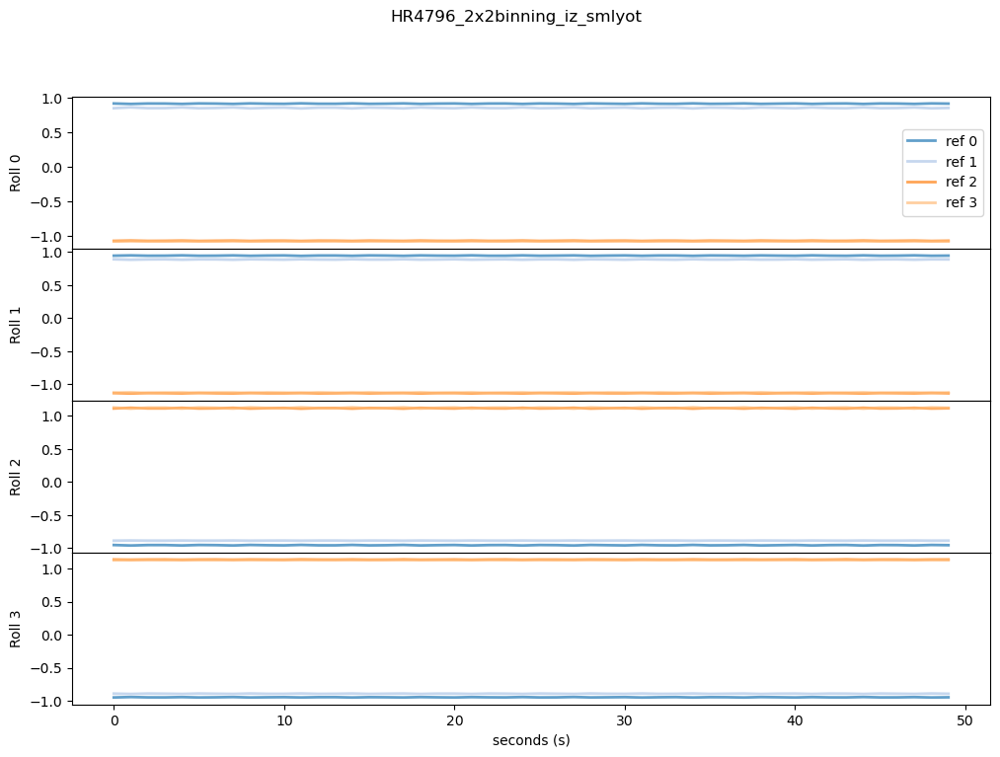

In [13]:
reload(sx)
data_allroll = np.array([sx.split_data_dot_roll(dot_0328_HR4796_avg, roll=i) for i in range(4)])
sx.plot_time_series_roll(data_allroll, 'HR4796_2x2binning_iz_smlyot', ref_avg = sx_0328_HR4796.ref_avg, hz=2000/(4*n_avg))

In [14]:
dot_0328_HR4796_avg_deroll = sx.pick_roll(dot_0328_HR4796_avg)

split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
Choosing roll index 1
split roll  (200, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

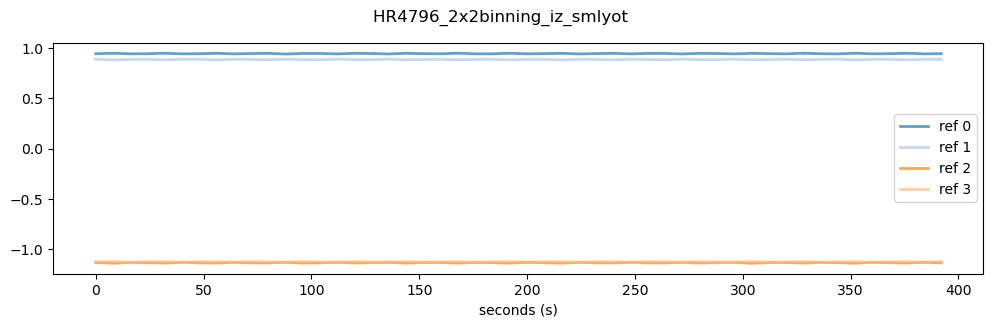

In [15]:
sx.plot_time_series(dot_0328_HR4796_avg_deroll, 'HR4796_2x2binning_iz_smlyot ', ref_avg = sx_0328_HR4796.ref_avg, hz=2000/(4*n_avg))

## 03_29 HD141569
many 5 min long datasets

HD141569_2x2binning_iz_smlyot		1564	2000	2.5	15	0.02	0


In [16]:
sx_0329_HD141569 = sx.SparkXrif('HD141569_2x2binning_iz_smlyot', 'spark_LAB_1564_2000_2mod_15ld_02amp', sx.glob_dir_calib, sx.glob_dark, sx.glob_mask, sx.glob_ref, sky_obs_n = 1)

Number of DATA files:  1477120
Number of REF files:  239104
GENERATING REFERENCE
PULLING 1024 FILES
FILE no 3, n_start 0, n 1024, n_offset 0
XRIF index 0, no of files 3, len list 467
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442120 bytes
  ratio:              0.505

xrif compression details:
  difference method:  none
  reorder method:     none
  compression method: none
  dimensions:         5 x 1 x 1 x 512
  raw size:           20480 bytes
  encoded size:       20480 bytes
  ratio:              1.000

xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 acceleration: 1
  dimensions:         120 x 120 x 1 x 512
  raw size:           14745600 bytes
  encoded size:       7442121 bytes
  ratio:              0.505

xrif compre

In [17]:
n_avg = 1000
dot_0329_HD141569_avg = sx_0329_HD141569.dot_list_pool_avg(n=200000, avg=n_avg)

[0, 4000, 8000, 12000, 16000, 20000, 24000, 28000, 32000, 36000, 40000, 44000, 48000, 52000, 56000, 60000, 64000, 68000, 72000, 76000, 80000, 84000, 88000, 92000, 96000, 100000, 104000, 108000, 112000, 116000, 120000, 124000, 128000, 132000, 136000, 140000, 144000, 148000, 152000, 156000, 160000, 164000, 168000, 172000, 176000, 180000, 184000, 188000, 192000, 196000]
N = 200000, chunk size = 4000, N_Chunks 50
PULLING 4000 FILES
FILE no 8, n_start 0, n 4000, n_offset 0
XRIF index 0, no of files 8, len list 2885
PULLING 4000 FILES
FILE no 8, n_start 52000, n 4000, n_offset 288
XRIF index 101, no of files 8, len list 2885
PULLING 4000 FILES
FILE no 8, n_start 104000, n 4000, n_offset 64
XRIF index 203, no of files 8, len list 2885
PULLING 4000 FILES
FILE no 8, n_start 156000, n 4000, n_offset 352
XRIF index 304, no of files 8, len list 2885
chunksize=13, n_workers=4
xrif compression details:
  difference method:  previous
  reorder method:     bytepack
  compression method: LZ4
    LZ4 ac

split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)
split roll  (200, 4)


<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

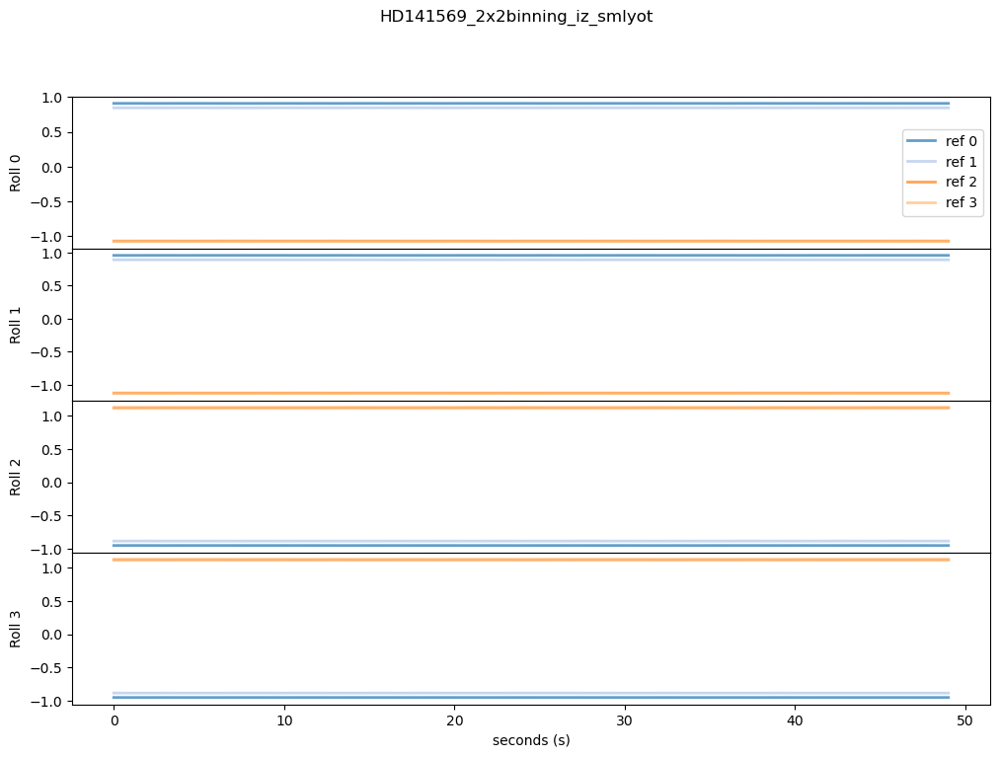

In [18]:
reload(sx)
data_allroll = np.array([sx.split_data_dot_roll(dot_0329_HD141569_avg, roll=i) for i in range(4)])
sx.plot_time_series_roll(data_allroll, 'HD141569_2x2binning_iz_smlyot', ref_avg = sx_0329_HD141569.ref_avg, hz=2000/(4*n_avg))

### 03_29 PSF-HD141569
many 5 min long datasets

1564	2000	2.5	15	0.02	0